![](https://www.dii.uchile.cl/wp-content/uploads/2021/06/Magi%CC%81ster-en-Ciencia-de-Datos.png)

# Proyecto: Innovación Tecnológica en Bodoque Bank

**MDS7202: Laboratorio de Programación Científica para Ciencia de Datos**

### Cuerpo Docente:

- Profesor: Pablo Badilla, Ignacio Meza De La Jara
- Auxiliar: Sebastián Tinoco
- Ayudante: Diego Cortez M., Felipe Arias T.

*Por favor, lean detalladamente las instrucciones de la tarea antes de empezar a escribir.*


----

## Reglas

- Fecha de entrega: 01/06/2021
- **Grupos de 2 personas.**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Estrictamente prohibida la copia. 
- Pueden usar cualquier material del curso que estimen conveniente.

# Motivación

![](https://www.geekmi.news/__export/1621969098810/sites/debate/img/2021/05/25/juan-carlos-bodoque-1.jpg_554688468.jpg)

Juan Carlos Bodoque, el famoso periodista y empresario, decidió diversificar su portafolio de negocios y crear su propio banco. Después de varios años de investigar y analizar el mercado financiero, finalmente logró fundar su entidad bancaria con el objetivo de ofrecer a sus clientes una experiencia personalizada y confiable en sus transacciones financieras. 

Sin embargo, con las nuevas tecnologías, aparecen nuevos desafíos para la joven entidad bancaria. Por ello, Bodoque decide invertir en un equipo de expertos en tecnología y finanzas, para que Bodoque Bank implemente las últimas innovaciones en seguridad y servicio al cliente para garantizar la satisfacción y fidelización de sus clientes.

El primer objetivo de la entidad bancaria será la detección de potenciales clientes fraudulentos, para ello Bodoque Bank les hace entrega de un extenso dataset en el que se registran las actividades que han realizado sus clientes durante los últimos meses. Uno de los puntos que resaltan al pasar el conjunto de datos es que el nombre de los usuarios está protegido y que consideren cada una de las filas como una muestra independiente de la otra.

Tras la solicitud, uno de los mayores accionistas del banco llamado Mario Hugo, les sugiere que al momento de realizar el proyecto tomen las siguientes consideraciones:

- Realicen un análisis exhaustivo de cada variable, ya que los directores tienden a ser quisquillosos con puntos o definiciones sin algún fundamento claro.
- Deben ser muy claros de cómo encontrar los outliers y si es posible expliquen cómo están determinando que un cliente es fraudulento.
- Es muy probable que existan clientes con diferentes comportamientos bancarios, por lo que sería muy buena decisión de separar a los clientes en grupos etarios.


### Definición Formal del Problema

El dataset con el que se trabajará en este primer proyecto será [_The Bank Account Fraud (BAF)_](https://www.kaggle.com/datasets/sgpjesus/bank-account-fraud-dataset-neurips-2022). Este consiste en un dataset para evaluar métodos de detección de fraudes bancarios, el cuál según sus autores es:

- Realista: Se basa en un actualizado dataset de casos reales de detección de fraude bancario.
- Sesgado: Poseen distintos tipos de bias.
- Desbalanceado: Clase positiva extremadamente pequeña.
- Dinámico: Presenta datos temporales y cambios de distribución.
- Preserva la privacidad: Protege a los potenciales clientes a través de la aplicación de privacidad diferencial.

El proyecto tiene por objetivo evaluar los conocimientos adquiridos en la primera mitad del curso, consistente en manejo de datos tabulares (I/O, manipulación, agregaciones, merge y visualizaciones) más la primera parte de modelos consistente en preprocesamiento de datos y detección de anomalías. Por ende, el proyecto consiste en dos tareas principales:

1. Generar un Análisis exploratorio de Datos (EDA) que describa completamente el dataset.
2. Buscar anomalías de forma automatizada.

**Importante:** Esta permitido el uso de librerías externas a las vistas en clases para profundizar aún mas en los análisis. Sin embargo, al momento de utilizar cualqueir metodo deberán explicar que hace y el porque de su aplicación.




# Proyecto

### Equipo:

- Johnny Godoy
- Las voces que atormentan a Johnny Godoy


### Link de repositorio de GitHub: `https://github.com/johnny-godoy/laboratorios-mds`




## 1. Introducción



En este proyecto, tenemos un dataset de clientes bancarios, es decir, donde cada fila representa a un cliente, caracterizado por los valores de las columnas. Nos interesa entonces:

* Mejorar nuestro entendimiento de los datos, en búsqueda de
* Desarrollar un algoritmo que logre predecir de forma automática cuáles cliente cometieron fraude,
* Y evaluar el desempeño de dicho algoritmo

Para lograr ésto, se utilizará un algoritmo de detección de anomalías en los datos del cliente, que buscará cuáles clientes tienen comportamiento anómalo con respecto al resto, es decir, si un dato sigue la distribución del resto. Éste algoritmo se entrenará de forma no supervisada, es decir, no tendrá acceso a las etiquetas que muestran si el cliente efectivamente cometió fraude.

Antes de entrenar este algoritmo, estamos interesados en realizar una buena exploración de datos para entenderlos mejor. En particular, veremos proyecciones en 2 dimensiones de los datos para buscar agrupaciones naturales.

Dado que pueden existir distintos comportamientos bancarios, se recomienda separar a los clientes por grupos etarios, por lo cuál se hará esto tanto en el análisis de datos como en el algoritmo, que separará según estos grupos.

Como tenemos acceso a etiquetas que indican si cometió un fraude realmente, se utilizarán para evaluar el desempeño del algoritmo, pero no para su entrenamiento.

### 1.1 Importación de librerías

In [35]:
# Librerías de Python
import abc
import contextlib
import os
import warnings
from typing import Iterator

# Librerías de terceros
import numpy as np
import pandas as pd
import plotly.express as px
from IPython.display import display
from plotly import graph_objects as go
from plotly.subplots import make_subplots
from sklearn.base import BaseEstimator, OutlierMixin, clone
from sklearn.compose import make_column_transformer
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
from sklearn.exceptions import NotFittedError
from sklearn.manifold import TSNE
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, RobustScaler
from sklearn.svm import OneClassSVM
from sklearn.utils import resample

with warnings.catch_warnings():  # Advertencia de Numba
    warnings.filterwarnings("ignore")
    import ydata_profiling

### 1.X Configuraciones

In [2]:
pd.options.plotting.backend = "plotly"

## 2. Lectura y Manejo de Datos




### 2.1 Cargar datos en dataframes

In [3]:
data_directory = "data/input/"
fuente_1 = pd.read_parquet(f"{data_directory}df_1.parquet")
fuente_2 = pd.read_parquet(f"{data_directory}df_2.parquet")
fuente_email_phone = pd.read_parquet(f"{data_directory}df_email_phone.parquet")

### 2.2 Exploración inicial

In [4]:
def exploracion_superficial(datos: pd.DataFrame) -> None:
    """Imprime información básica de un conjunto de datos."""
    print(f"Número de filas: {datos.shape[0]}")
    print(f"Número de columnas: {datos.shape[1]}")
    print("Cabecera:")
    display(datos.head())
    print("Información:")
    print(datos.info())

In [5]:
datasets = {
    "Fuente 1": fuente_1,
    "Fuente 2": fuente_2,
    "Fuente Email Phone": fuente_email_phone,
}
for nombre, data in datasets.items():
    print(f"Dataset: {nombre}")
    exploracion_superficial(data)
del datasets

Dataset: Fuente 1
Número de filas: 389782
Número de columnas: 29
Cabecera:


,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
104446,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,500.0,0,INTERNET,8.865992,windows,0,0,2,-0.245425,0.568811
269483,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,200.0,0,INTERNET,4.654872,linux,1,0,7,0.009336,-2.096682
4102,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1500.0,0,INTERNET,3.720953,linux,1,0,1,2.229616,-0.005823
351767,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,200.0,0,INTERNET,2.912670,windows,1,0,3,-0.193945,0.861207
126377,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,200.0,0,INTERNET,2.283680,other,1,0,3,-2.440650,0.354986


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 389782 entries, 104446 to 193209
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            389782 non-null  int64  
 1   fraud_bool                    389782 non-null  int64  
 2   income                        389782 non-null  float64
 3   prev_address_months_count     389782 non-null  int64  
 4   current_address_months_count  389782 non-null  int64  
 5   customer_age                  389782 non-null  int64  
 6   days_since_request            389782 non-null  float64
 7   intended_balcon_amount        389782 non-null  float64
 8   payment_type                  389782 non-null  object 
 9   zip_count_4w                  389782 non-null  int64  
 10  velocity_6h                   389782 non-null  float64
 11  velocity_24h                  389782 non-null  float64
 12  velocity_4w               

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
699954,303612,0,0.8,-1,21,40,0.010837,-0.853976,AD,239,...,200.0,0,INTERNET,48.127390,other,0,0,3,0.236931,0.077061
701206,568066,0,0.9,-1,70,50,0.711485,25.137456,AA,1873,...,200.0,0,INTERNET,8.792273,windows,1,0,3,0.571536,1.151563
270304,893344,0,0.7,-1,133,50,0.006856,-0.815330,AC,675,...,1000.0,0,INTERNET,15.916225,other,1,0,7,0.224252,-0.590459
346538,247688,0,0.8,-1,207,50,0.026194,-0.736615,AB,999,...,200.0,0,INTERNET,0.509942,linux,1,0,6,0.648528,-0.315911
147297,674478,0,0.8,-1,24,50,0.012646,10.744253,AA,3198,...,500.0,1,INTERNET,10.562945,other,0,0,6,0.041475,0.383332


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 747410 entries, 699954 to 384611
Data columns (total 29 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   id                            747410 non-null  int64  
 1   fraud_bool                    747410 non-null  int64  
 2   income                        747410 non-null  float64
 3   prev_address_months_count     747410 non-null  int64  
 4   current_address_months_count  747410 non-null  int64  
 5   customer_age                  747410 non-null  int64  
 6   days_since_request            747410 non-null  float64
 7   intended_balcon_amount        747410 non-null  float64
 8   payment_type                  747410 non-null  object 
 9   zip_count_4w                  747410 non-null  int64  
 10  velocity_6h                   747410 non-null  float64
 11  velocity_24h                  747410 non-null  float64
 12  velocity_4w               

,id,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
987231,624588,0.555653,15,0,1,0,1
79954,620810,0.849718,2,0,1,0,0
567130,580633,0.110898,3,0,1,1,0
500891,6379,0.671250,15,0,1,0,1
55399,366511,0.772932,7,0,1,0,1


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 934730 entries, 987231 to 986114
Data columns (total 7 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   id                                934730 non-null  int64  
 1   name_email_similarity             934730 non-null  float64
 2   date_of_birth_distinct_emails_4w  934730 non-null  int64  
 3   email_is_free                     934730 non-null  int64  
 4   device_distinct_emails_8w         934730 non-null  int64  
 5   phone_home_valid                  934730 non-null  int64  
 6   phone_mobile_valid                934730 non-null  int64  
dtypes: float64(1), int64(6)
memory usage: 57.1 MB
None


### 2.3 Unir dataframes

In [6]:
datos_unidos = pd.concat([fuente_1, fuente_2])
exploracion_superficial(datos_unidos)
del fuente_1, fuente_2

Número de filas: 1137192
Número de columnas: 29
Cabecera:


,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,proposed_credit_limit,foreign_request,source,session_length_in_minutes,device_os,keep_alive_session,device_fraud_count,month,x1,x2
104446,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,500.0,0,INTERNET,8.865992,windows,0,0,2,-0.245425,0.568811
269483,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,200.0,0,INTERNET,4.654872,linux,1,0,7,0.009336,-2.096682
4102,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1500.0,0,INTERNET,3.720953,linux,1,0,1,2.229616,-0.005823
351767,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,200.0,0,INTERNET,2.912670,windows,1,0,3,-0.193945,0.861207
126377,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,200.0,0,INTERNET,2.283680,other,1,0,3,-2.440650,0.354986


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1137192 entries, 104446 to 384611
Data columns (total 29 columns):
 #   Column                        Non-Null Count    Dtype  
---  ------                        --------------    -----  
 0   id                            1137192 non-null  int64  
 1   fraud_bool                    1137192 non-null  int64  
 2   income                        1137192 non-null  float64
 3   prev_address_months_count     1137192 non-null  int64  
 4   current_address_months_count  1137192 non-null  int64  
 5   customer_age                  1137192 non-null  int64  
 6   days_since_request            1137192 non-null  float64
 7   intended_balcon_amount        1137192 non-null  float64
 8   payment_type                  1137192 non-null  object 
 9   zip_count_4w                  1137192 non-null  int64  
 10  velocity_6h                   1137192 non-null  float64
 11  velocity_24h                  1137192 non-null  float64
 12  velocity_4w

### 2.4 Unir nuevas variables

In [7]:
df_sin_limpieza = pd.merge(datos_unidos, fuente_email_phone, how="outer")
exploracion_superficial(df_sin_limpieza)

Número de filas: 1198151
Número de columnas: 35
Cabecera:


,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,device_fraud_count,month,x1,x2,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
0,729517,0.0,0.7,-1.0,305.0,60.0,0.030059,-1.599455,AC,990.0,...,0.0,2.0,-0.245425,0.568811,0.883485,2.0,1.0,1.0,0.0,1.0
1,729517,0.0,0.7,-1.0,305.0,60.0,0.030059,-1.599455,AC,990.0,...,0.0,2.0,-0.245425,0.568811,0.883485,2.0,1.0,1.0,0.0,1.0
2,149585,0.0,0.8,-1.0,140.0,50.0,0.015659,3.951994,AA,1269.0,...,0.0,7.0,0.009336,-2.096682,0.113208,4.0,1.0,1.0,1.0,1.0
3,149585,0.0,0.8,-1.0,140.0,50.0,0.015659,3.951994,AA,1269.0,...,0.0,7.0,0.009336,-2.096682,0.113208,4.0,1.0,1.0,1.0,1.0
4,64486,0.0,0.9,-1.0,171.0,50.0,0.001409,28.159779,AB,4430.0,...,0.0,1.0,2.229616,-0.005823,0.792797,4.0,0.0,1.0,0.0,1.0


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 1198151 entries, 0 to 1198150
Data columns (total 35 columns):
 #   Column                            Non-Null Count    Dtype  
---  ------                            --------------    -----  
 0   id                                1198151 non-null  int64  
 1   fraud_bool                        1137192 non-null  float64
 2   income                            1137192 non-null  float64
 3   prev_address_months_count         1137192 non-null  float64
 4   current_address_months_count      1137192 non-null  float64
 5   customer_age                      1137192 non-null  float64
 6   days_since_request                1137192 non-null  float64
 7   intended_balcon_amount            1137192 non-null  float64
 8   payment_type                      1137192 non-null  object 
 9   zip_count_4w                      1137192 non-null  float64
 10  velocity_6h                       1137192 non-null  float64
 11  velocity_24h            

### 2.5 Verificar nulos y duplicados, generar explicaciones sobre sus fuentes y proponer soluciones.



#### 2.5.1 Nulos

In [8]:
df_sin_limpieza.isnull().sum().sort_values()

id                                      0
x2                                  60959
x1                                  60959
month                               60959
device_fraud_count                  60959
keep_alive_session                  60959
device_os                           60959
session_length_in_minutes           60959
source                              60959
foreign_request                     60959
proposed_credit_limit               60959
has_other_cards                     60959
housing_status                      60959
credit_risk_score                   60959
bank_months_count                   60959
bank_branch_count_8w                60959
fraud_bool                          60959
income                              60959
prev_address_months_count           60959
current_address_months_count        60959
employment_status                   60959
days_since_request                  60959
customer_age                        60959
payment_type                      

La cantidad más alta de valores nulos (79727) se comparte por 5 características
provenientes del dataset `df_email_phone.parquet`. Todo el resto de características (salvo el índice)
tiene la misma cantidad de nulos (60959).

Esto se puede explicar por el método de unión de los dataframes, que es `outer`,
que une los dataframes por el índice, y cuando existen índices en solamente uno de los dataframes,
entonces las columnas del otro dataframe quedan con valores nulos en el dataframe final.

Comprobemos esto realizando los distintos tipos de uniones:

* `inner`: Esperamos que no haya nulos.
* `left`: Esperamos que haya 79727 nulos en las columnas de `df_email_phone
.parquet`, y 0 en el resto de las columnas.
* `right`: Esperamos que haya 60959 nulos en las columnas de `df_1.parquet` y `df_2
.parquet`, y 0 en el resto de las columnas.

In [9]:
pd.DataFrame(
    {
        tipo: pd.merge(datos_unidos, fuente_email_phone, how=tipo).isnull().sum()
        for tipo in ("inner", "left", "right", "outer")
    }
)

,inner,left,right,outer
id,0,0,0,0
fraud_bool,0,0,60959,60959
income,0,0,60959,60959
prev_address_months_count,0,0,60959,60959
current_address_months_count,0,0,60959,60959
customer_age,0,0,60959,60959
days_since_request,0,0,60959,60959
intended_balcon_amount,0,0,60959,60959
payment_type,0,0,60959,60959
zip_count_4w,0,0,60959,60959


Efectivamente es así, por lo cual la hipótesis es correcta.


Como nuestro interés es la actividad fraudulenta, esta característica no debería ser
nula, por lo que se pueden eliminar los casos donde ésta es desconocida. A pesar de
ser una cantidad considerable de datos (79727), no dan suficiente información valiosa,
en consideración que es solamente información de email y teléfono, y no de la actividad
del usuario.

Esto se puede realizar fácilmente usando un `left` join, en vez de `outer`, sin
incurrir en la pérdida de información de un `inner` join.

Dado esto, podríamos considerar también eliminar las filas sin información de
`df_email_phone.parquet`. Sin embargo, esto eliminaría 60959 filas que sí tienen
mucha información valiosa en la actividad del cliente. Por lo tanto, se deciden
formas de imputar estas características.

Para utilizar una estrategia simple, consideramos que todas las variables agregadas
son no negativas, por lo cuál se imputarán con -1. Esta decisión evita modificar la
distriución de las variables categóricas agregadas, y además, es una decisión
consistente con la ya tomada en las otras características proporcionadas.

#### 2.5.2 Duplicados

In [10]:
df_sin_limpieza.duplicated().sum()

202334

Existen muchísimos duplicados. Ya sabíamos que existían duplicados en los dataframes
`df_1.parquet` con `df_2.parquet`. Consideramos una versión con estos eliminados para
buscar otros duplicados.

In [11]:
df_prelimpio = df_sin_limpieza.drop_duplicates()
df_prelimpio["id"].duplicated().sum()

0

Acá vemos que cada `id` es único. Esto es bueno, pues nos asegura que no hay
duplicados de usuarios, asumiendo que el `id` es un identificador único de usuario.
Ninguna otra característica es un identificador único, por lo cual no revisamos
otras características.

### 2.5.3 Columnas constantes

df_sin_limpieza.nunique().sort_values()

Se vé que `device_frad_count` es una columna constante, así que se puede eliminar.

### 2.6 Limpiar

In [12]:
df_limpio = (
    pd.merge(datos_unidos, fuente_email_phone, how="left")  # Elimina nulos df_1, df_2
    .drop(columns=["device_fraud_count"])  # Elimina columna constante
    .fillna(-1)  # Imputa con -1
    .drop_duplicates()  # Elimina filas duplicadas
)
exploracion_superficial(df_limpio)

Número de filas: 934858
Número de columnas: 34
Cabecera:


,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,keep_alive_session,month,x1,x2,name_email_similarity,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid
0,729517,0,0.7,-1,305,60,0.030059,-1.599455,AC,990,...,0,2,-0.245425,0.568811,0.883485,2.0,1.0,1.0,0.0,1.0
1,149585,0,0.8,-1,140,50,0.015659,3.951994,AA,1269,...,1,7,0.009336,-2.096682,0.113208,4.0,1.0,1.0,1.0,1.0
2,64486,0,0.9,-1,171,50,0.001409,28.159779,AB,4430,...,1,1,2.229616,-0.005823,0.792797,4.0,0.0,1.0,0.0,1.0
3,825283,0,0.5,-1,85,30,0.027292,-1.310498,AB,1698,...,1,3,-0.193945,0.861207,0.865082,10.0,0.0,1.0,0.0,1.0
4,8308,0,0.9,-1,39,30,0.010945,-1.450972,AC,569,...,1,3,-2.440650,0.354986,0.450024,13.0,1.0,1.0,0.0,0.0


Información:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 934858 entries, 0 to 1137191
Data columns (total 34 columns):
 #   Column                            Non-Null Count   Dtype  
---  ------                            --------------   -----  
 0   id                                934858 non-null  int64  
 1   fraud_bool                        934858 non-null  int64  
 2   income                            934858 non-null  float64
 3   prev_address_months_count         934858 non-null  int64  
 4   current_address_months_count      934858 non-null  int64  
 5   customer_age                      934858 non-null  int64  
 6   days_since_request                934858 non-null  float64
 7   intended_balcon_amount            934858 non-null  float64
 8   payment_type                      934858 non-null  object 
 9   zip_count_4w                      934858 non-null  int64  
 10  velocity_6h                       934858 non-null  float64
 11  velocity_24h                      9348

In [13]:
print(f"Columnas eliminadas: {df_sin_limpieza.shape[1] - df_limpio.shape[1]}")
print(f"Filas eliminadas: {df_sin_limpieza.shape[0] - df_limpio.shape[0]}")

Columnas eliminadas: 1
Filas eliminadas: 263293


### 2.7 Agregar rango etario

In [14]:
df = df_limpio.copy()
df["segmentacion_etaria"] = pd.cut(
    df["customer_age"],
    bins=[-np.inf, 18, 26, 59, np.inf],
    labels=["Joven", "Adulto-Joven", "Adulto", "Persona Mayor"],
    right=False,
)
if not os.path.exists("data/interim/df.csv"):
    df.to_csv("data/interim/df.csv", index=False)

### 2.8 Eliminar variables innecesarias del runtime

In [15]:
del df_limpio
del df_prelimpio
del datos_unidos
del fuente_email_phone
del df_sin_limpieza

## 3. Análisis Exploratorio de Datos

### 3.1 Análisis del EDA

In [16]:
@contextlib.contextmanager
def switch_to_backend(backend: str) -> Iterator[None]:
    """Cambia el backend de pandas a uno de los disponibles.
    Esto es necesario para que pandas-profiling pueda generar los gráficos.
    Ver: https://github.com/ydataai/ydata-profiling/issues/1071
    Al finalizar, vuelve al backend original.

    """
    old_backend = pd.options.plotting.backend
    pd.options.plotting.backend = backend
    yield
    pd.options.plotting.backend = old_backend

In [17]:
profile = ydata_profiling.ProfileReport(df, title="EDA")
filename = "output/reports/eda.html"
if not os.path.exists(filename):
    with switch_to_backend("matplotlib"):
        profile.to_file(filename)

Ver reporte en [este link](https://johnny-godoy.github.io/laboratorios-mds/2023/proyecto/output/reports/eda.html).

#### 3.1.1 Análisis de distribuciones univariadas

Primero había escrito mis observaciones de cada una de las distribuciones. Luego noté
que había un README que contenía mucho de lo que observé. Por lo tanto, decidí
combinar la anotación del README (en inglés) con mis observaciones (en español).

- Ya se limpiaron valores nulos y duplicados, y se vieron los tipos de dato de cada
variable en la exploración superficial.
- **id** es un identificador único de usuario
- **fraud_bool (binary)**: If the application is fraudulent or not. Está
desbalanceada, con un 1% de casos positivos, tal como se esperaba.
- **income (numeric)**: Annual income of the applicant (in decile form). Ranges between
[0.1, 0.9]. Sorprendentemente, la distribución no parece exponencial como es usual para valores
monetarios, sino que bimodal con picos en los extremos.
- **prev_address_months_count (numeric)**: Number of months in previous registered
address of the applicant, i.e. the applicant’s previous residence, if applicable. Ranges
between [−1, 380] months (-1 is a missing value). La variable es un conteo, así que
es discreta, con el resto de valores naturales. Tiene muchos más valores imputados
que **current_address_months_count**, lo que se explica porque esta variable se
indefine en el primer mes del cliente.
**current_address_months_count (numeric)**: Months in currently registered address of
the applicant. Ranges between [−1, 429] months (-1 is a missing value). A pesar de
ser un conteo, no tiene valores nulos. Su distribución es más fácil de determinar que
 en el caso anterior porque no dominan los valores imputados. Parece ser una Poisson
 con un grado pequeño de imputación.
- **customer_age (numeric)**: Applicant’s age in years, rounded to the decade. Ranges
between [10, 90] years. La mayoría de los usuarios son adultos, entre 40 y 60 años. El grupo entre
20 y 40 años también es considerable, pero grupos menores y mayores son pequeños.
Sería inesperado tener a menores de 18 años como clientes, pero no es imposible, y
existe un cliente de 10 años.
- **days_since_request (numeric)**: Number of days passed since application was done.
Ranges between [0, 79] days. No es una variable discreta como puede parecer de la
descripción, sino que es continua. Toma valores fraccionarios, lo cual
puede ser en caso de que la solicitud haya sido hecha en el mismo día que se hizo el
dataset. Esto es extraño, pues la media es 0.9 y los datos están fuertemente
concentrados en 0, y es anómalo que haya valores mayores a 1.
- **intended_balcon_amount (numeric)**: Initial transferred amount for application.
Ranges between [−16, 114] (negatives are missing values). Es una variable continua fuertemente centrada en
valores negativos, formando 75.2% de los datos en el segmento [-15, 0), con el resto
en el rango [0, 112]. Es decir, la mayoría de valores fueron imputados.
- **payment_type (categorical)**: Credit payment plan type. 5 possible (annonymized)
values. No es claro si existe una relación de orden. AE es muy poco frecuente, con
solamente 221 datos. El resto de categorías tienen muchos más ejemplos, con AB
dominando.
- **zip_count_4w (numeric)**: Number of applications within same zip code in last 4 weeks.
Ranges between [1, 6830]. Ees una variable de conteo, pero que admite muchos valores
distintos, pareciendo continua. Es bimodal, con cola larga en el extremo derecho.
- **velocity_6h, velocity_24h, `velocity_4w** Velocity of total applications made in
last [X time] i.e., average number of applications per hour in the last [X time]. Son
 variables continuas. Todas tienen una media entre 4000 y 5000. Solamente la primera tiene valores negativos.
Todas están positivamente correlacionadas entre sí.
- **bank_branch_count_8w (numeric)**: Number of total applications in the selected
bank branch in last 8 weeks. Ranges between [0, 2404]. Muy concentrada en 0, tomando
el 14% de los valores. El resto de valores son positivos, como es conteo. La
distribución no se distingue bien por la cantidad de ceros, pero la media es 200. Se
detecta una alta correlación con `velocity_24h`.
- **employment_status (categorical)**: Employment status of the applicant. 7 possible
(anonymized) values. No es claro si existe una relación de orden. La categoría `CA`
es la más frecuente, con ~64% de los datos.
- **credit_risk_score (numeric)**: Internal score of application risk. Ranges between
[−191, 389]. Es una variable continua con distribución normal centrada en
 139.26.
- **housing_status (categorical)**: Current residential status for applicant. 7 possible
(anonymized) values.No es claro si existe una relación de
 orden. Existen categorías con muy pocos datos
- **bank_months_count (numeric)**: How old is previous account (if held) in months.
Ranges between [−1, 32] months (-1 is a missing value). Es una
variable de conteo sin hay valores 0. Varios de estos valores son muy poco
 frecuentes, con algunos segmentos más frecuentes.
- **has_other_cards (binary)**: If applicant has other cards from the same banking
company. Tiene distribución 75-25 entre no y sí.
- **proposed_credit_limit (numeric)**: Applicant’s proposed credit limit. Ranges between
[200, 2000]. Es discreta, con 12 valores distintos. Muchos de estos son del mínimo
200 (tiene sentido que el valor por defecto sea el mínimo para un cliente nuevo).
- **foreign_request (binary)**: If origin country of request is different from bank’s
 country. Tiene gran desbalance, solamente 2.4% de los datos son positivos.
- **source (categorical)**: Online source of application. Either browser (INTERNET) or
app (TELEAPP). La gran mayoría son de `INTERNET`, con 99.3% de los datos.
Podría codificarse como la variable binaria `is_internet`.
- **session_length_in_minutes (numeric)**: Length of user session in banking website in
minutes. Ranges between [−1, 107] minutes (-1 is a missing value). Su distribución es
Gamma imputada en -1.
- **device_os (categorical)**: Operative system of device that made request. Possible values
are: Windows, macOS, Linux, X11, or other. Los más comunes son linux,
windows y el valor `otros` que agrupa a los desconocidos. No hay sistemas móbiles.
- **keep_alive_session (binary)**: User option on session logout. Está bien balanceada.
- **month (numeric)**: Month in which the application was made. Ranges between [0, 7]. Cada valor está balanceado. Está muy
negativamente correlacionada con `velocity_4w`, y un tanto menos con otras velocidades.
-**x_1, x_2** son variables sospechosamente cercanas a $\mathcal{N}(0, 1)$, tanto así
que parecen ser simuladas. No están reportadas en el README. Cada valor es distinto.
Tienen correlación casi nula con toda variable salvo con `fraud_bool`.
- **name_email_similarity (numeric)**: Metric of similarity between email and
applicant’s
name. Higher values represent higher similarity. Ranges between [0, 1]. La
distribución es multimodal, parece una suma de gaussianas, salvo una gran
concentración en la mediana (0.48) dado la imputación realizada.
- **date_of_birth_distinct_emails_4w (numeric)**: Number of emails for applicants with
same date of birth in last 4 weeks. Ranges between [0, 39]. La variable es discreta.
Parece tener distribución positivamente asimétrica, pero al imputar el valor -1, se
agrega otra moda.
-**email_is_free, phone_home_valid, phone_mobile_valid** son variables binarias, a
las cuales se les agregó un tercer valor -1 que indica que el dato es faltante. Las
primeras dos quedan razonablemente balanceadas, mientras que la última tiene un
desbalance de 80-20.
- **device_distinct_emails (numeric)**: Number of distinct emails in banking website from
the used device in last 8 weeks. Ranges between [−1, 2] emails (-1 is a missing
value). La variable ya tenía una imputación -1, por lo cuál la decisión fue consistente.
- **segmentacion_etaria (categorical)** es la categorización construida: Como se mencionó, adulto es
por mucho la categoría dominante. Adulto-joven y persona mayor están balanceadas, y
hay muy pocos jóvenes. Es ordinal por construcción.

In [18]:
### 3.1.2. Análisis Bivariado

Con `plotly` podemos obtener una matriz de correlación interactiva.

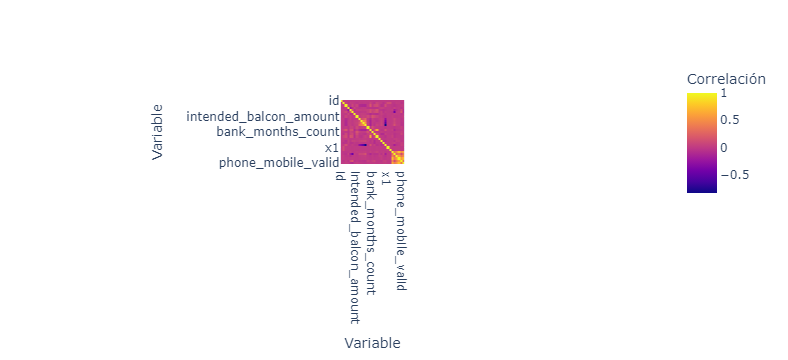

In [19]:
corr = df.corr(numeric_only=True)
imcorr = px.imshow(corr, labels=dict(x="Variable", y="Variable", color="Correlación"))
imcorr.write_image("output/figures/corr.png")
imcorr.show()

Las observaciones importantes respecto a correlación se realizaron en la parte anterior, pero acá pudimos verificarlo con mayor facilidad.

Dado que queremos estudiar `fraud_bool`, podemos ordenar las variables por su
correlación absoluta con esta.

In [20]:
corr_fraud = corr["fraud_bool"].sort_values(key=np.abs, ascending=False)
corr_fraud

fraud_bool                          1.000000
x2                                  0.119184
x1                                  0.118848
credit_risk_score                   0.068053
proposed_credit_limit               0.068014
keep_alive_session                 -0.048956
income                              0.041074
has_other_cards                    -0.037976
phone_home_valid                   -0.034738
intended_balcon_amount             -0.023751
current_address_months_count        0.023259
prev_address_months_count          -0.021881
email_is_free                       0.021614
customer_age                        0.018744
name_email_similarity              -0.017923
foreign_request                     0.016953
date_of_birth_distinct_emails_4w   -0.016801
bank_branch_count_8w               -0.013838
velocity_6h                        -0.013802
device_distinct_emails_8w           0.010829
zip_count_4w                        0.009522
session_length_in_minutes           0.006522
bank_month

`x1` y `x2` son las variables más correlacionadas con `fraud_bool`, y son las
variables que notamos sospechosas antes. Será bueno ver su distribución agrupando por
 `fraud_bool`. Debido al gran tiempo de ejecución de `plotly`, se utiliza un muestreo
  estratificado.

In [21]:
def muestreo(dataframe: pd.DataFrame, frac: float = 0.1) -> pd.DataFrame:
    """Obtiene un muestreo estratificado por la variable `fraud_bool`.

    Args:
        dataframe (pd.DataFrame): Dataframe a muestrear.
         Debe tener la columna `fraud_bool`.
        frac (float, optional): Fracción de datos a muestrear. Por defecto es 0.1.

    Returns:
        pd.DataFrame: Muestra estratificada.
    """
    return (
        dataframe.groupby("fraud_bool")
        .apply(lambda x: x.sample(frac=frac, random_state=0))
        .reset_index(drop=True)
    )

In [22]:
muestra = muestreo(df[["x1", "x2", "fraud_bool"]].copy())

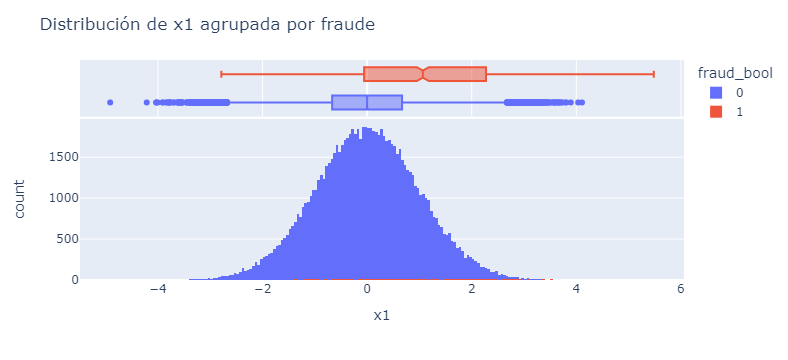

In [23]:
fig = px.histogram(muestra, x="x1", color="fraud_bool", marginal="box")
fig.update_layout(barmode="overlay", title="Distribución de x1 agrupada por fraude")
fig.write_image("output/figures/x1.png")
fig.show()

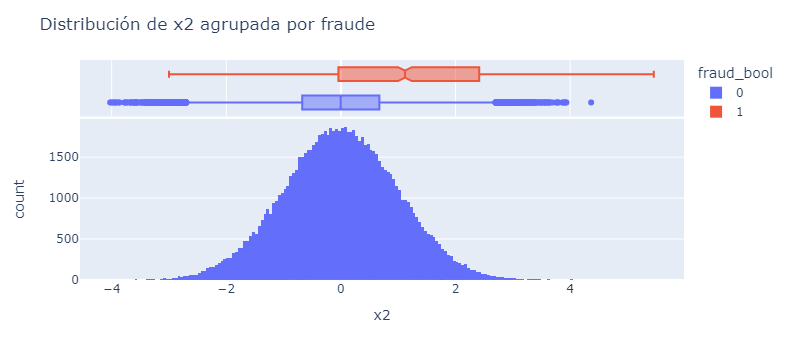

In [24]:
fig = px.histogram(muestra, x="x2", color="fraud_bool", marginal="box")
fig.update_layout(barmode="overlay", title="Distribución de x2 agrupada por fraude")
fig.write_image("output/figures/x2.png")
fig.show()

Estas distribuciones ya muestran potenciales clasificadores débiles de fraude, como
considerar $x_1>4$ o $x_2>3.25$ como fraude. Cómo ambas distribuciones son parecidas, pero no correlacionadas, se podría pensar en un clasificador que considere ambas variables, para lo que vemos un gráfico de dispersión.

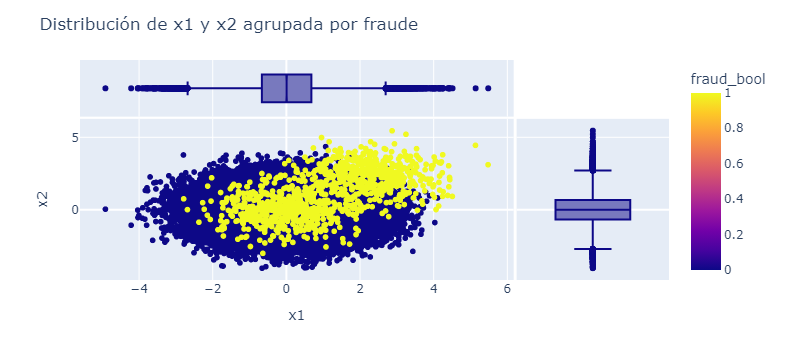

In [25]:
fig = px.scatter(
    muestra, x="x1", y="x2", color="fraud_bool", marginal_x="box", marginal_y="box"
)
fig.update_layout(title="Distribución de x1 y x2 agrupada por fraude")
fig.write_image("output/figures/x1x2_by_fraud.png")
fig.show()

Viendo las distribuciones, parece que los no-fraudes están en una circunferencia de radio 4 centrada en el origen. Por otro lado, los fraudes parecen estar en dos circunferencias, una centrada en el origen de menor radio que los no-fraudes, y otra centrada en $(2.5, 2.5)$.

## 4. Preprocesamiento

### 4.1 Declarar `ColumnTransformer`

* Se utilizará `OneHotEncoder` para las variables nominales y OrdinalEncoder para las
ordinales
* Debido a que luego se hará una reducción de dimensionalidad, todas las variables
deben ser escaladas. Tanto en la documentación de `PCA` como `TSNE` se recomienda el
uso de `StandardScaler`, pero debido a que la imputación de valores cambió la
distribución de las variables, se utilizará `RobustScaler`.
* Las excepciones son las variables sin transformar `id` y `fraud_bool`.

Sin embargo, `segmentación_etaria` es la única variable que se sabe que es ordinal.
`source` y `device_os` son nominales claramente. `payment_type`, `employment_status`
 y `housing_status` podrían ser ordinales, pero como están anonimizadas, no sabemos
 su orden correcto, y una codificación que no altere el orden podría ser perjudicial.
Ninguna de las características tiene tantas categorías como para que usar
OneHotEncoder sea un problema de dimensionalidad grave.

In [26]:
nominals = [
    "payment_type",
    "employment_status",
    "housing_status",
    "source",
    "device_os",
]
ordinals = ["segmentacion_etaria"]
excluded = ["id", "fraud_bool"]
numericals = list(set(df.columns).difference(nominals + ordinals + excluded))
categorical_transformer = make_column_transformer(
    (
        OneHotEncoder(
            sparse_output=False,
            drop="first",
            handle_unknown="infrequent_if_exist",
        ),
        nominals,
    ),
    (
        OrdinalEncoder(
            handle_unknown="use_encoded_value",
            unknown_value=-1,
        ),
        ordinals,
    ),
    remainder="passthrough",
)
transformer = make_column_transformer(
    (RobustScaler(), numericals),
    (
        make_pipeline(
            categorical_transformer,
            RobustScaler(),
        ),
        nominals + ordinals,
    ),
    remainder="passthrough",
)
transformer.set_output(transform="pandas")

ColumnTransformer(remainder='passthrough',
                  transformers=[('robustscaler', RobustScaler(),
                                 ['days_since_request', 'x2',
                                  'phone_home_valid', 'phone_mobile_valid',
                                  'current_address_months_count', 'velocity_6h',
                                  'credit_risk_score', 'foreign_request',
                                  'customer_age', 'name_email_similarity',
                                  'session_length_in_minutes', 'velocity_4w',
                                  'bank_branch_count_8w', 'has_othe...
                                                                                                 handle_unknown='infrequent_if_exist',
                                                                                                 sparse_output=False),
                                                                                   ['payment_type',
                                                                                    'employment_status',
                                                                                    'housing_status',
                                                                                    'source',
                                                                                    'device_os']),
                                                                                  ('ordinalencoder',
                                                                                   OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                                                  unknown_value=-1),
                                                                                   ['segmentacion_etaria'])])),
                                                 ('robustscaler',
                                                  RobustScaler())]),
                                 ['payment_type', 'employment_status',
                                  'housing_status', 'source', 'device_os',
                                  'segmentacion_etaria'])])

## 5. Visualización en Baja Dimensionalidad

### 5.1 Muestrear dataframe

Realizamos el muestreo de forma estratificada, pues de otra manera la proporción de
fraudes en el muestreo podría ser demasiado baja. Ya hicimos una función que hace
algo similar, pero por simplicidad queremos que el parámetro sea el número de
muestras, por lo que aprovechamos la utilidad de scikit-learn. Dado que se separará
por la segmentación etaria, también se utilizará al estratificar.

In [27]:
muestra = resample(
    df,
    replace=False,
    n_samples=10_000,
    random_state=0,
    stratify=df[["fraud_bool", "segmentacion_etaria"]],
)

In [28]:
muestra.groupby("segmentacion_etaria").agg(
    {"fraud_bool": ["mean", "count"]}
).reset_index()

segmentacion_etaria fraud_bool      
                            mean count
0               Joven   0.007692   130
1        Adulto-Joven   0.006127  1469
2              Adulto   0.011151  7174
3       Persona Mayor   0.016300  1227

### 5.2 Proyectar y agregar proyecciones al dataframe de muestreo

`TSNE` es un método preferido a `PCA` debido a poder aprender no-linealidades, pero
es más lento.

Para reducir el costo computacional, una recomendación en la documentación de
scikit-learn, es utilizar previamente `PCA` para reducir la dimensionalidad a un
espacio de menor dimensionalidad para reducir tanto el tiempo de ejecución como el
ruido. Ya sabemos que existen variables correlacionadas, y más aún se generó una
redundante.

Sin embargo, no se quiere perder demasiada información, así que no es deseable bajar
la dimensionalidad demasiado. Se determina la cantidad de dimensiones que `PCA`
utilizará de forma automática con el parámetro `mle`.

Experimentos realizados (que no se muestran) determinan que el dataset transformado
tiene dimensión 51, y la reducción de `PCA`solamente pasó a 48, por lo que no se
espera haber perdido demasiada información, pero sí haber reducido el ruido y
redundancia.

In [29]:
proyector = make_pipeline(
    transformer,
    PCA(
        n_components="mle",
        random_state=0,
        whiten=True,
    ),
    TSNE(
        random_state=0,
        perplexity=50.0,
        n_jobs=-2,
    ),
)
muestra_con_proyeccion = muestra.copy()
muestra_con_proyeccion[["x", "y"]] = proyector.fit_transform(
    muestra.drop(columns=excluded)
)

### 5.3 Visualizar según rangos etarios

Verificaremos si la segmentación etaria respeta la proporción de fraudes.

In [30]:
def plot_fraudes_por_segmentacion_etaria(agrupado, columna="fraud_bool"):
    fig = make_subplots(
        rows=2,
        cols=2,
        subplot_titles=list(agrupado.groups.keys()),
        shared_xaxes=True,
        shared_yaxes=True,
        vertical_spacing=0.05,
        horizontal_spacing=0.05,
    )
    for i, (segmento, grupo) in enumerate(agrupado):
        row, col = divmod(i, 2)
        fig.add_trace(
            go.Scatter(
                x=grupo["x"],
                y=grupo["y"],
                mode="markers",
                marker=dict(
                    color=grupo[columna],
                    colorscale="RdYlGn",
                ),
                name=segmento,
            ),
            row=row + 1,
            col=col + 1,
        )
    fig.update_layout(
        title=f"Proyección de los datos en 2D {columna}",
        template="plotly",
    )
    fig.write_image(f"output/figures/proyeccion_{columna}.png")
    fig.show()

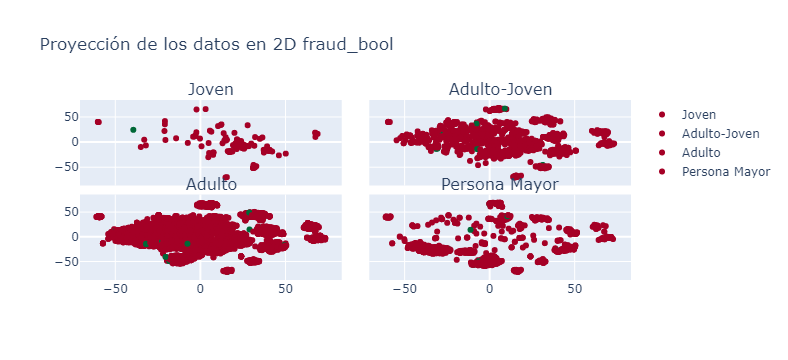

In [31]:
agrupado = muestra_con_proyeccion.groupby("segmentacion_etaria")
plot_fraudes_por_segmentacion_etaria(agrupado)

No se encontraron patrones importantes. No se reporta todo lo que se intentó,
incluyendo:

* Eliminar el uso de `PCA`
* Eliminar el uso de `TSNE`
* Cambiar el valor de `perplexity` en el range $[5, 50]$, como se recomienda en
scikit-learn, y según su guía de cuáles utilizar. Los valores pequeños mostraban
esencialmente una esfera uniforme, lo que indica que es mejor aumentar los valores.

Tomar el valor `perplexity` $50$ sí mostraba grupos, pero ninguno interesante o correlacionado con
fraude. Más aún, los distintos segmentos etarios solamente se diferenciaban por su
cantidad de puntos, y los grupos más pequeños parecían subconjuntos del grupo más
grande, el de los adultos. Esto significa que las dimensiones encontradas no está
separando por segmentación etaria.

Otra recomendación en scikit-learn es correr el algoritmo varias veces con distintas
semillas y quedarse con el mejor resultado. Sin embargo, esto también aumenta el
riesgo de encontrar patrones falsos, por lo que no se realizó más que una vez.

## 6. Anomalías

### 6.1 Implementar detector de anomalías sobre dataframe de muestreo

Se implementará una clase que realiza detección de anomalías segmentada por rango
etario, y que permita el cálculo de los ratios $P$ y $R$. La clase
`AnomaliaPorRangoEtario` recibe como argumento otro estimador de scikit-learn que
haga detección de anomalías, para entrenar a uno por cada rango etario.

In [32]:
class BaseOutlierEstimator(OutlierMixin, BaseEstimator, abc.ABC):
    """Base para estimadores de detección de anomalías."""

    @abc.abstractmethod
    def fit(self, X, y=None):
        """Entrena el modelo para encontrar anomalías.

        Parameters
        ----------
        X : array-like of shape (n_samples, n_features)
            Datos de entrenamiento.

        y: array-like of shape (n_samples,), default=None
            Solamente se incluye para respetar la interfaz de scikit-learn.

        Returns
        -------
        self : object
            Instancia del modelo.
        """
        return self

    @abc.abstractmethod
    def predict(self, X):
        """Predice si cada punto es una anomalía o no.

        Parameters
        ----------
        X : array-like of shape (n_samples, n_features)
            Datos de entrenamiento.

        Returns
        -------
        y : ndarray of shape (n_samples,)
            Etiquetas de cada punto. 1 si es una anomalía, 0 si no lo es.
        """

In [33]:
class AnomaliaPorRangoEtario(BaseOutlierEstimator):
    """Detector de anomalías por rango etario.
    Entrena un modelo por cada rango etario, y predice si un cliente es un fraude
    o no según el modelo correspondiente a su rango etario.

    Parameters
    ----------
    modelo_base : BaseOutlierEstimator
        Modelo base para detectar anomalías. Debe implementar `fit` y `predict`,
        como lo hacen OneClassSVM y IsolationForest, pero a diferencia de
        LocalOutlierFactor.

    Attributes
    ----------
    modelos_: dict[str, BaseOutlierEstimator]
        Modelos entrenados por rango etario.
    """

    def __init__(self, *, modelo_base: BaseOutlierEstimator):
        self.modelo_base = modelo_base
        self.modelos_ = None

    def fit(self, X, y=None):
        X_agrupado = X.groupby("segmentacion_etaria")
        self.modelos_ = {
            segmento: clone(self.modelo_base).fit(grupo)  # type: ignore
            for segmento, grupo in X_agrupado
        }
        return self

    def predict(self, X):
        if self.modelos_ is None:
            raise NotFittedError(
                f"El modelo {self} no ha sido entrenado. Debe llamar a `fit` antes."
            )
        y = pd.Series(np.empty(len(X), dtype=np.int64), index=X.index)
        X_agrupado = X.groupby("segmentacion_etaria")
        for modelo, (_, grupo) in zip(self.modelos_.values(), X_agrupado):
            # Pasando a la codificación (-1, 1) de IsolationForest y OneClassSVM
            # a la codificación (0, 1) de nuestro dataset
            y[grupo.index] = (modelo.predict(grupo) < 0).astype(np.int64)
        return y

    def get_pr_ratios(self, X, y):
        """
        Obtiene los ratios P y R

        Parameters
        ----------
        X: array-like of shape (n_samples, n_features)
            Datos a predecir.
        y: array-like of shape (n_samples,)
            Etiquetas reales.

        Returns
        -------
        p: float
            Cantidad de ejemplos predichos correctamente como fraude
            / cantidad total de datos predichos como fraude.
        r: float
            Cantidad de ejemplos predichos correctamente como fraude
            / cantidad total de ejemplos que eran realmente fraude.
        """
        y_pred = self.predict(X)

        tp = np.sum(y_pred & y)  # ejemplos predichos correctamente como fraude
        tot_fraud = np.sum(y)  # cantidad total de ejemplos que eran realmente fraude
        pred_fraud = np.sum(y_pred)  # cantidad total de datos predichos como fraude

        with warnings.catch_warnings():
            warnings.filterwarnings("ignore")
            p = tp / pred_fraud
            r = tp / tot_fraud
        return p, r

Como detector base, se intentaron dos distintos algoritmos de scikit-learn: `IsolationForest` y `OneClassSVM`. Se analizarán ambos a modo de comparación. Solamente se reportan los mejores hiperparámetros encontrados.

In [37]:
forest_base = make_pipeline(transformer, IsolationForest(random_state=0, n_jobs=-2))
svm_base = make_pipeline(transformer, OneClassSVM(kernel="sigmoid"))
modelo_forest = AnomaliaPorRangoEtario(modelo_base=forest_base)
modelo_svm = AnomaliaPorRangoEtario(modelo_base=svm_base)
X = muestra.drop(columns=["fraud_bool"])
modelo_forest.fit(X)
modelo_svm.fit(X)

AnomaliaPorRangoEtario(modelo_base=Pipeline(steps=[('columntransformer',
                                                    ColumnTransformer(remainder='passthrough',
                                                                      transformers=[('robustscaler',
                                                                                     RobustScaler(),
                                                                                     ['days_since_request',
                                                                                      'x2',
                                                                                      'phone_home_valid',
                                                                                      'phone_mobile_valid',
                                                                                      'current_address_months_count',
                                                                                      'velocity_6h',
                                                                                      'credit_risk_score',
                                                                                      'foreign_request',
                                                                                      'customer_age',
                                                                                      'name_email_similarity',
                                                                                      's...
                                                                                                                                        'employment_status',
                                                                                                                                        'housing_status',
                                                                                                                                        'source',
                                                                                                                                        'device_os']),
                                                                                                                                      ('ordinalencoder',
                                                                                                                                       OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                                                                                                      unknown_value=-1),
                                                                                                                                       ['segmentacion_etaria'])])),
                                                                                                     ('robustscaler',
                                                                                                      RobustScaler())]),
                                                                                     ['payment_type',
                                                                                      'employment_status',
                                                                                      'housing_status',
                                                                                      'source',
                                                                                      'device_os',
                                                                                      'segmentacion_etaria'])])),
                                                   ('oneclasssvm',
                                                    OneClassSVM(kernel='sigmoid'))]))

### 6.2 Agregar resultados a dataframe de muestreo

In [38]:
muestra_con_proyeccion["fraud_pred_forest"] = modelo_forest.predict(X).values
muestra_con_proyeccion["fraud_pred_svm"] = modelo_svm.predict(X).values
muestra_con_proyeccion.head()

,id,fraud_bool,income,prev_address_months_count,current_address_months_count,customer_age,days_since_request,intended_balcon_amount,payment_type,zip_count_4w,...,date_of_birth_distinct_emails_4w,email_is_free,device_distinct_emails_8w,phone_home_valid,phone_mobile_valid,segmentacion_etaria,x,y,fraud_pred_forest,fraud_pred_svm
206800,766430,0,0.5,59,7,50,0.004772,-1.352772,AC,867,...,10.0,1.0,1.0,0.0,1.0,Adulto,-37.580669,9.187181,0,0
826623,70573,0,0.8,-1,83,20,0.009813,-0.629146,AB,2154,...,5.0,0.0,1.0,1.0,1.0,Adulto-Joven,0.561668,-8.586325,0,1
83700,803428,0,0.8,-1,127,40,0.019343,-1.226536,AD,1114,...,8.0,1.0,1.0,0.0,1.0,Adulto,9.339795,-29.421509,0,0
713880,707628,0,0.3,-1,141,50,0.023301,-0.525135,AB,711,...,4.0,0.0,1.0,1.0,0.0,Adulto,-21.276649,-21.966311,0,0
347218,245258,0,0.4,-1,54,50,0.028080,49.077796,AA,2807,...,5.0,1.0,1.0,1.0,1.0,Adulto,-1.008532,33.868965,0,1


### 6.3 Visualizar según rangos etarios

Corrí esta celda con escepticismo, debido a que las proyecciones de fraudes no dieron
 resultados interesantes, entonces las predicciones tampoco serían buenos.

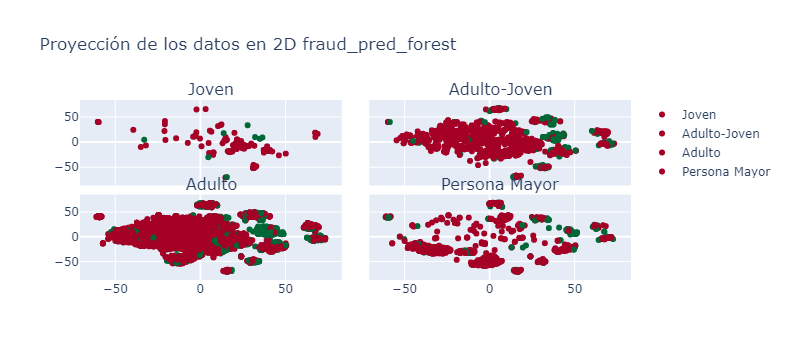

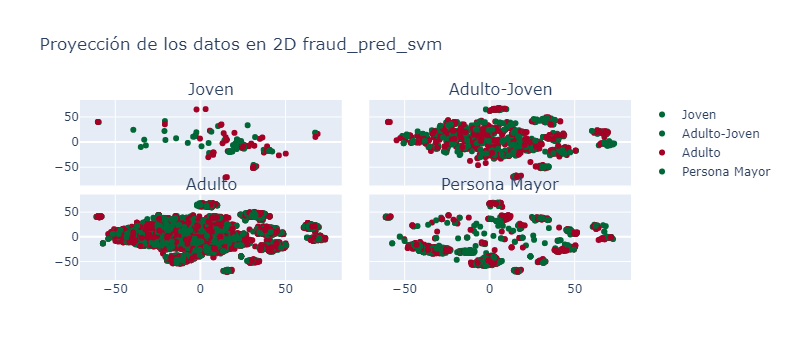

In [39]:
agrupado = muestra_con_proyeccion.groupby("segmentacion_etaria")
plot_fraudes_por_segmentacion_etaria(agrupado, "fraud_pred_forest")
plot_fraudes_por_segmentacion_etaria(agrupado, "fraud_pred_svm")

Sin embargo, sí podemos ver agrupaciones donde se concentran los fraudes, y parecen estar más en el lado derecho del gráfico. Esto se nota más para los adultos y adultos jóvenes, pero esto se puede explicar porque son los grupos mayoritarios, y los otros grupos tienen muy pocos datos como para formar ese patrón.

En ambos casos, la cantidad de anomalías parece ser considerablemente mayor a la cantidad de fraudes, pero esto es especialmente cierto para `OneClassSVM`. Determinamos cuántos fraudes hay realmente, y cuantos se predicen.

In [40]:
muestra_con_proyeccion[["fraud_bool", "fraud_pred_forest", "fraud_pred_svm"]].mean()

fraud_bool           0.011
fraud_pred_forest    0.095
fraud_pred_svm       0.500
dtype: float64

1% de los datos son fraudes, pero `IsolationForest` predice 10% de anomalías, y `OneClassSVM` predice el 50% de anomalías.

Esto hace que `OneClassSVM` sea totalmente inviable en la práctica, a pesar de que vamos a ver que tiene mejores ratios P y R. `IsolationForest` tiene peores ratios, pero predice una mucho menor cantidad de fraudes, por lo que no incurre en tanto costo de un falso positivo.

### 6.4 Calcular ratios y responder

Para poder comparar los ratios, es necesario entender una línea base. Para esto, definimos un `DummyOutlierDetector`, que predice completamente al azar.

In [43]:
class DummyOutlierDetector(BaseOutlierEstimator):
    """Base para estimadores de detección de anomalías."""

    def __init__(self, *, random_state=None, fraud_ratio=0.1):
        self.random_state = 0
        self.fraud_ratio = fraud_ratio
        self._rng = np.random.default_rng()

    def fit(self, X, y=None):
        return super().fit(X, y)

    def predict(self, X):
        if self.fraud_ratio is None:
            raise NotFittedError(
                f"El modelo {self} no ha sido entrenado. Debe llamar a `fit` antes."
            )
        y = self._rng.random(len(X)) <= self.fraud_ratio
        return pd.Series(y, index=X.index)


modelo_dummy = AnomaliaPorRangoEtario(modelo_base=DummyOutlierDetector(random_state=0))
modelo_dummy.fit(X)

AnomaliaPorRangoEtario(modelo_base=DummyOutlierDetector(random_state=0))

In [44]:
modelos = {
    "DummyOutlierDetector": modelo_dummy,
    "IsolationForest": modelo_forest,
    "OneClassSVM": modelo_svm,
}
y = muestra_con_proyeccion["fraud_bool"]
for base, modelo in modelos.items():
    print(f"Modelo: {base}")
    print(10 * "-")
    p, r = modelo.get_pr_ratios(X, y)
    print(f"Ratio P: {p}")
    print(f"Ratio R: {r}")
    print()

Modelo: DummyOutlierDetector
----------
Ratio P: nan
Ratio R: 0.0

Modelo: IsolationForest
----------
Ratio P: 0.009473684210526316
Ratio R: 0.08181818181818182

Modelo: OneClassSVM
----------
Ratio P: 0.0118
Ratio R: 0.5363636363636364



Con esto, respondemos las preguntas propiestas:

- ¿Qué significan los ratios y sus valores?

Ambos ratios son valores entre 0 y 1, que indican qué tan correctas fueron las predicciones de nuestro modelo

En el caso de P, están normalizdas según la cantidad de fraudes reales, es decir, nos
 dice cuantos de los fraudes reales se lograron predecir. Este es el recall.

 Por otro lado, en el caso de R, están normalizadas según la cantidad de datos predichos como fraude, es decir, nos dice cuantos de los datos predichos como fraude eran realmente
 fraude. Esta es la precisión.


- ¿Qué tan correctas fueron las predicciones realizadas por su modelo según los ratios calculados?

En ningún caso las métricas fueron muy altas, pero fueron mejores que las generadas azarosamente. En el caso de `IsolationForest`, solamente 0.9% de los fraudes se lograron predecir, y 9% de los datos predichos como fraude lo eran efectivamente.

`OneClassSVM` da una pequeña mejora en recall y una gran mejora en precisión, con más de 53%. Sin embargo, esto se explica por el gran desbalance de datos, está prediciendo que 50% de los datos son fraudulentos, y así logra buena precisión. Pero si predice que cualquier 50% de los datos es fraudulento, también se esperaría alcanzar este mismo nivel de precisión, aunque con potencialmente menor recall.

- ¿Son coherentes los resultados obtenidos?.

Sí. Los fraudes son un tipo particular de anomalías. El modelo simplemente está
prediciendo otro tipo de anomalías, que no habría razón para esperar que coincidan o
se correlacionen con los fraudes, en especial porque el algoritmo utilizado para
encontrar las anomalías fue no supervisado, es decir, no tiene información alguna de
cuáles datos corresponden a fraudes y cuáles no.

El modelo de mejor desempeño según las métricas propuestas es `OneClassSVM`, pero esto es porque las métricas propuestas no toman en consideración el desbalance del problema, y por lo tanto no es un modelo práctico.

- ¿Cómo se comportan los casos de fraudes para los diferentes rangos etarios?

Cómo se determinó en la pregunta anterior, no existe ninguna relación interesante (es
 decir, que no se explique por el ruido) entre los fraudes y los rangos etarios.